<a href="https://colab.research.google.com/github/Gr3gP/Thinkful-Projects/blob/main/Identifying_Celestial_Bodies.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Intent

The pupose of this paper is to use dimensionality reduction techniques and apply clutering algorithms to identify different types of celestial objects using data from the Sloan Digital Sky Survey. It can be found here: __[Kaggle]('https://www.kaggle.com/muhakabartay/sloan-digital-sky-survey-dr16')__.


#Why does this Research Matter?

- This data comes from the Sloan Digital Sky Survey
- The SDSS seeks to map the entire universe and to date, has produced the most detailed 3 dimensional images of the universe
- This is done with the coordinating of dozens of satellites and other measurement instruments
- The data we are looking at is concerned with three objects: stars, galaxies, and quasars
-Stars and galaxies are fairly common phenomenon, but quasars are not


#What is a Quasar:

- A Quasar is an object that has a supper massive blackhole at its center thousands of times larger than our sun, and formed either from the collapse of a massive star, or another way. 
- The blackhole then starts sucking galactic material into what are called accretion discs.
- As this material falls into the accretion discs, which are spinning at millions of miles an hour, it gets super heated and begin to glow very intensely. 
- This is what glows brighter than galaxies that are millions of light years closer to us





#Data Overview

This data comes from the Sloan Digital Sky Survey which seeks to 'Map the Universe'. The data is compiled by about a half dozen telescopes and satellites imaging various swaths of the night sky. To date, the SDSS has created more detailed and accurate 3-dimensional maps of our universe. 

The survey seeks to identify three types of objects. Stars, galaxys, and quasars based on 16 attributes. A brief description of them is as follows:

objid = Object Identifier

ra = J2000 Right Ascension (r-band)

dec = J2000 Declination (r-band)

u = better of deV/Exp magnitude fit (u-band)

g = better of deV/Exp magnitude fit (g-band)

r = better of deV/Exp magnitude fit (r-band)

i = better of deV/Exp magnitude fit (i-band)

z = better of deV/Exp magnitude fit (z-band)

run = Run Number

rerun = Rerun Number

camcol = Camera column

field = Field number

specobjid = Object Identifier

class = object class (galaxy, star or quasar object)

redshift = Final Redshift

plate = plate number

mjd = MJD of observation

fiberid = fiberID

Our data contains 100,000 rows and 17 variables. 'ra' and 'dec' are the coordinates, in degrees, of the object. 'u', 'g', 'r', 'i', 'z' are all light color measurements of the object on a logarithmic scale. r'un', 'rerun', 'camcol', and 'field' all describe a field, which is a piece of the entire image. The other variables are various identifiers. Our data also has the 'ground truth' of our objects contained in the 'class' variable.

#Approach

We will first explore the data and then run some dimensionality techniques to visualize the data. Then we will train some clsutering algorithms to expose the underlying similarities in the data. I should also note that we have the 'ground truth' of our data. However, we will still run some clustering and dimensionality models with differnt specifications of clusters and components, repectively.

#References

http://skyserver.sdss.org/dr8/en/tools/search/

https://www.sdss.org/science/

https://esahubble.org/images/opo9635a1/


#EDA and Data Cleaning

In [ ]:
import pandas as pd
import numpy as np
from google.colab import drive
drive.mount('/content/drive')
sdss_df = pd.read_csv('/content/drive/MyDrive/Thinkful Data Science/Skyserver_12_30_2019 4_49_58 PM.csv.zip')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
sdss_dfr = sdss_df.copy()

In [ ]:
sdss_df.head(10)

,objid,ra,dec,u,g,r,i,z,run,rerun,camcol,field,specobjid,class,redshift,plate,mjd,fiberid
0,1237666301628060000,47.372545,0.820621,18.69254,17.13867,16.55555,16.34662,16.17639,4849,301,5,771,8168632633242440000,STAR,0.000115,7255,56597,832
1,1237673706652430000,116.303083,42.455980,18.47633,17.30546,17.24116,17.32780,17.37114,6573,301,6,220,9333948945297330000,STAR,-0.000093,8290,57364,868
2,1237671126974140000,172.756623,-8.785698,16.47714,15.31072,15.55971,15.72207,15.82471,5973,301,1,13,3221211255238850000,STAR,0.000165,2861,54583,42
3,1237665441518260000,201.224207,28.771290,18.63561,16.88346,16.09825,15.70987,15.43491,4649,301,3,121,2254061292459420000,GALAXY,0.058155,2002,53471,35
4,1237665441522840000,212.817222,26.625225,18.88325,17.87948,17.47037,17.17441,17.05235,4649,301,3,191,2390305906828010000,GALAXY,0.072210,2123,53793,74
5,1237668294987420000,178.334659,20.751715,15.44680,13.88656,13.06969,12.68676,12.42432,5313,301,6,125,2831738116518210000,GALAXY,0.020701,2515,54180,363
6,1237668294985060000,172.597478,20.552722,19.10002,17.10998,16.05751,15.63390,15.26723,5313,301,6,89,2812665437882440000,GALAXY,0.130948,2498,54169,609
7,1237668294984930000,172.309005,20.581135,16.89111,16.29741,16.25994,16.86333,16.77033,5313,301,6,87,2814772926945980000,GALAXY,0.004703,2500,54178,84
8,1237669517979620000,2.117128,7.663761,17.82389,16.75859,16.30879,16.13584,16.07477,5598,301,4,129,12733034184836400000,STAR,-0.000355,11309,58428,844
9,1237658423557820000,169.129790,7.152575,17.47752,16.23605,15.61560,15.29749,15.03419,3015,301,3,367,1820656067877560000,GALAXY,0.037549,1617,53112,276


In [ ]:
sdss_df.shape

(100000, 18)

In [ ]:
sdss_df.isnull().sum()/sdss_df.count()

objid        0.0
ra           0.0
dec          0.0
u            0.0
g            0.0
r            0.0
i            0.0
z            0.0
run          0.0
rerun        0.0
camcol       0.0
field        0.0
specobjid    0.0
class        0.0
redshift     0.0
plate        0.0
mjd          0.0
fiberid      0.0
dtype: float64

It appears we don't have any null or missing values to fill.

In [ ]:
sdss_df.dtypes

objid          int64
ra           float64
dec          float64
u            float64
g            float64
r            float64
i            float64
z            float64
run            int64
rerun          int64
camcol         int64
field          int64
specobjid     uint64
class         object
redshift     float64
plate          int64
mjd            int64
fiberid        int64
dtype: object

In [ ]:
sdss_df.describe()

,objid,ra,dec,u,g,r,i,z,run,rerun,camcol,field,specobjid,redshift,plate,mjd,fiberid
count,1.000000e+05,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.0,100000.000000,100000.000000,1.000000e+05,100000.000000,100000.000000,100000.000000,100000.000000
mean,1.237663e+18,177.512888,25.052056,18.637915,17.407128,16.881676,16.625534,16.467087,3978.727640,301.0,3.274010,187.243080,2.913905e+18,0.170621,2587.984270,53913.908690,341.699080
std,7.264931e+12,78.039070,20.567259,0.832284,0.985921,1.133337,1.209532,1.281788,1691.498597,0.0,1.621208,141.037298,2.488872e+18,0.437571,2210.547391,1547.244489,217.068614
min,1.237646e+18,0.013061,-19.495456,10.611810,9.668339,9.005167,8.848403,8.947795,109.000000,301.0,1.000000,11.000000,2.994897e+17,-0.004136,266.000000,51608.000000,1.000000
25%,1.237658e+18,136.356526,6.770380,18.212902,16.852982,16.196608,15.865275,15.619960,2826.000000,301.0,2.000000,85.000000,1.335426e+18,0.000001,1186.000000,52733.000000,160.000000
50%,1.237662e+18,180.411688,23.918611,18.873250,17.515860,16.890640,16.599885,16.428385,3900.000000,301.0,3.000000,153.000000,2.354330e+18,0.045997,2091.000000,53726.000000,328.000000
75%,1.237667e+18,224.369107,40.344539,19.273302,18.056060,17.585750,17.344912,17.234625,5061.000000,301.0,5.000000,249.000000,3.276384e+18,0.095429,2910.000000,54585.000000,502.000000
max,1.237681e+18,359.999615,84.490494,19.599950,19.996050,31.990100,32.141470,29.383740,8162.000000,301.0,6.000000,982.000000,1.317645e+19,7.011245,11703.000000,58543.000000,1000.000000


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

Looking at some of the correlations between our variables, it appears their are not many strong correlations. The ones that do exist are between the imaging varaiables and that is somewhat expected. The same image will have a relatively strong correlation between 'u', 'g', 'r', 'i',  and 'z' variables. We will explore this further with scatter plots.  

#EDA Visualizations

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline
import plotly.express as px

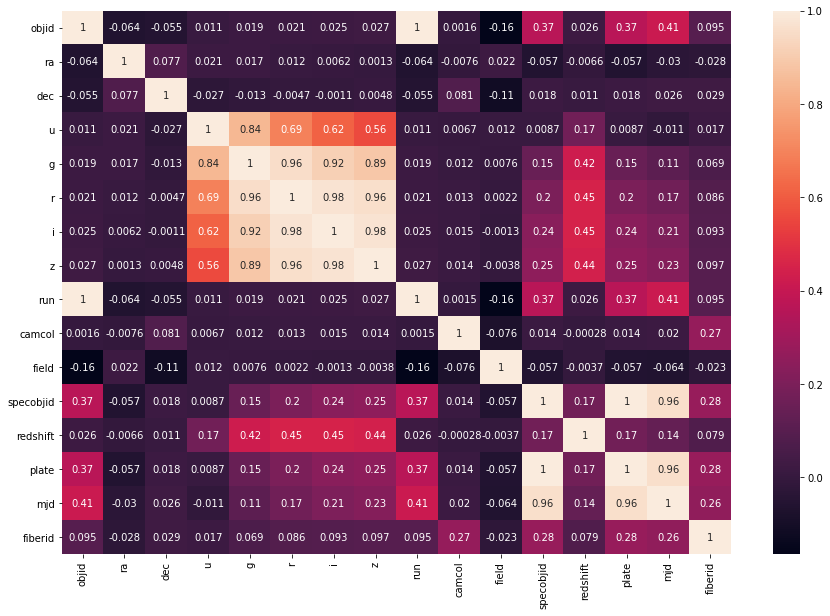

In [ ]:
corr = sdss_df.corr()
plt.figure(figsize = (15, 10))
sns.heatmap(corr, annot = True)

In [ ]:
for col in sdss_df:
  plt.figure(figsize=(10,5))
  plt.subplot(2,4,2)
  plt.hist(sdss_df[col])
  plt.xlabel(col)
  plt.show()

Looking at the above histograms, we can see that some are normally distributed like objid, dec, and run. While others are very skewed or even discontinuous. Next, we will split the data into their respective classes and run boxplots on each variable. We are looking for a difference in the outliers between some variables and classes. This should expose any variables that are a dead giveaway for a certain class.

In [ ]:
sdss_df['rerun'].unique()

array([301])

Its odd that rerun only has one value. Becuase of this, I see no convincing reason to not drop it from our data.

In [ ]:
sdss_df = sdss_df.drop(['rerun'], axis=1)

In [ ]:
sdss_df.head()

,objid,ra,dec,u,g,r,i,z,run,camcol,field,specobjid,class,redshift,plate,mjd,fiberid
0,1237666301628060000,47.372545,0.820621,18.69254,17.13867,16.55555,16.34662,16.17639,4849,5,771,8168632633242440000,STAR,0.000115,7255,56597,832
1,1237673706652430000,116.303083,42.455980,18.47633,17.30546,17.24116,17.32780,17.37114,6573,6,220,9333948945297330000,STAR,-0.000093,8290,57364,868
2,1237671126974140000,172.756623,-8.785698,16.47714,15.31072,15.55971,15.72207,15.82471,5973,1,13,3221211255238850000,STAR,0.000165,2861,54583,42
3,1237665441518260000,201.224207,28.771290,18.63561,16.88346,16.09825,15.70987,15.43491,4649,3,121,2254061292459420000,GALAXY,0.058155,2002,53471,35
4,1237665441522840000,212.817222,26.625225,18.88325,17.87948,17.47037,17.17441,17.05235,4649,3,191,2390305906828010000,GALAXY,0.072210,2123,53793,74


In [ ]:
sdss_df['class'].unique()

array(['STAR', 'GALAXY', 'QSO'], dtype=object)

In [ ]:
star_sdss_df = sdss_df[sdss_df['class'] == 'STAR']
galaxy_sdss_df = sdss_df[sdss_df['class'] == 'GALAXY']
qso_sdss_df = sdss_df[sdss_df['class'] == 'QSO']

print(star_sdss_df.shape)
print(galaxy_sdss_df.shape)
print(qso_sdss_df.shape)

(38096, 17)
(51323, 17)
(10581, 17)


In [ ]:
star_sdss_df.drop(['class'], axis=1, inplace=True)
galaxy_sdss_df.drop(['class'], axis=1, inplace=True)
qso_sdss_df.drop(['class'], axis=1, inplace=True)

/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:4174: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



**NOTE**:Looking at our data, it is not very balanced. Quasars make up just over 10% or our data which may pose a problem for our clustering algorithms. Galaxys make up just over half all our data and stars make up a bit more than a third. 

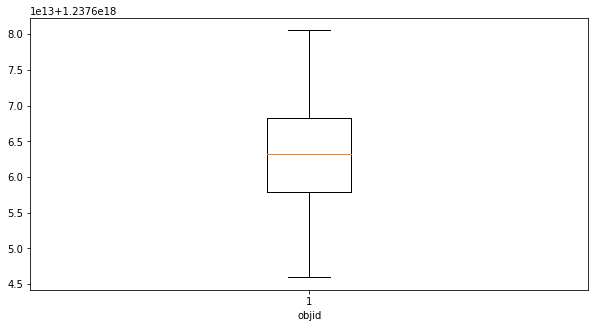

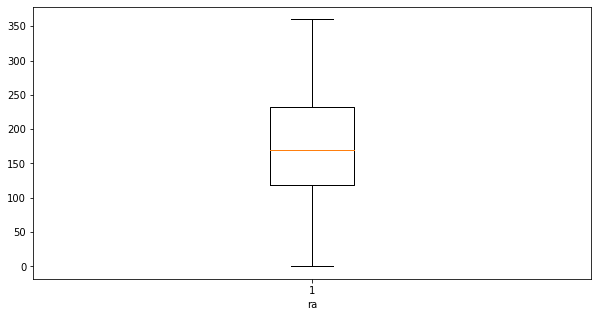

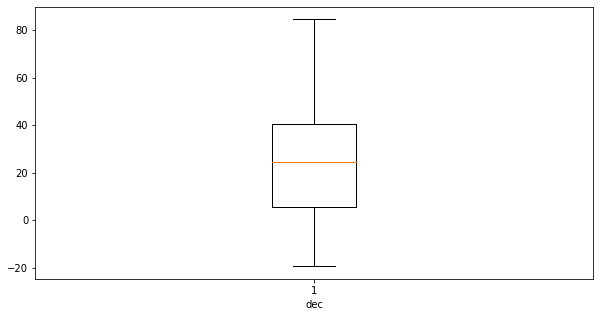

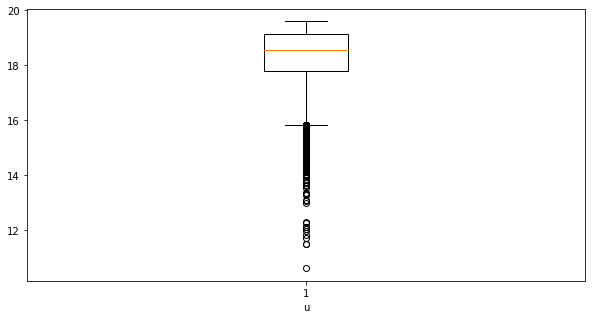

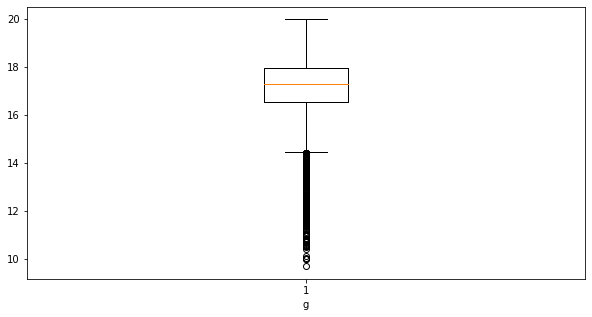

...

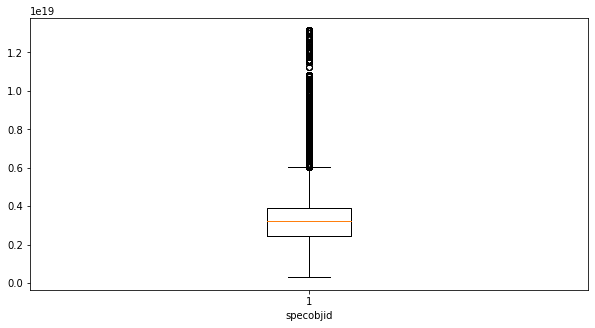

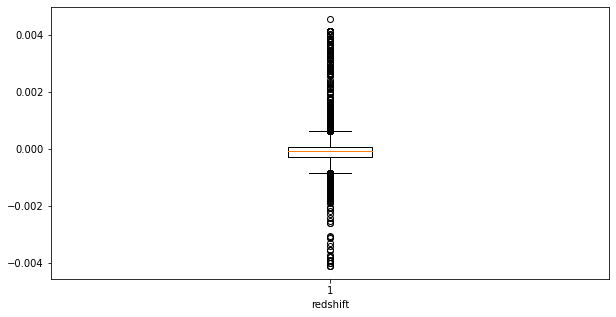

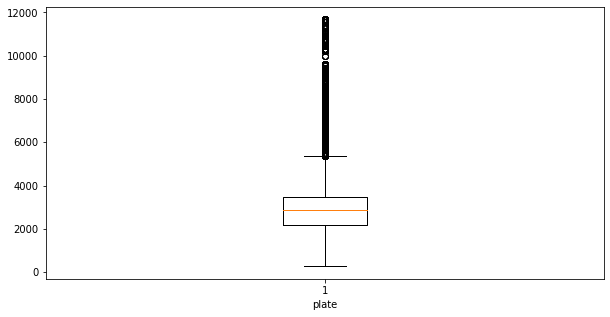

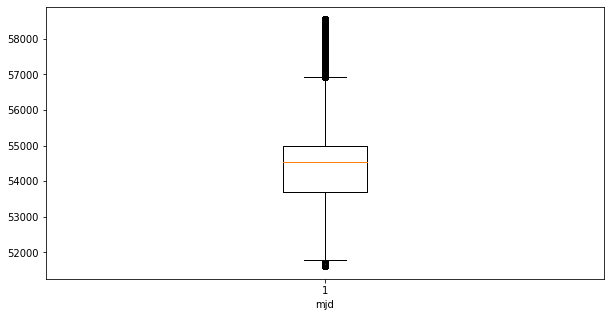

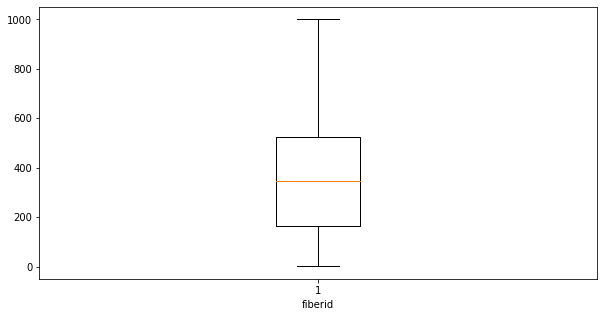

In [ ]:
for col in star_sdss_df:
  plt.figure(figsize=(10,5))
  plt.boxplot(star_sdss_df[col])
  plt.xlabel(col)
  plt.show()

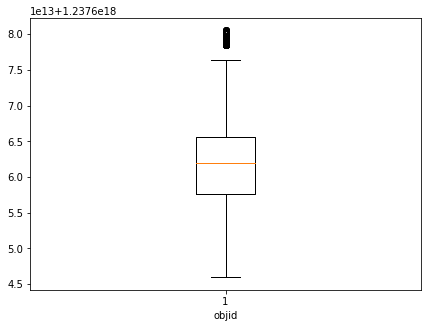

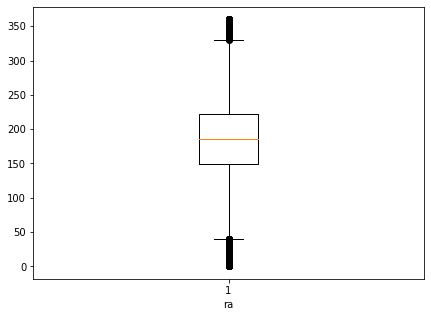

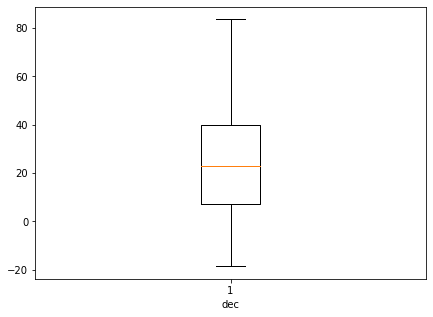

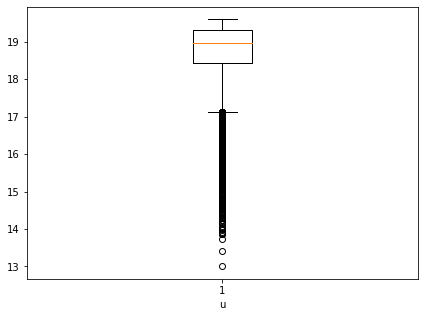

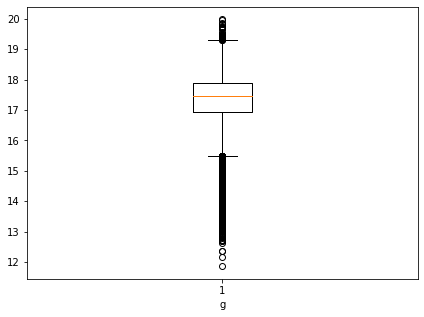

...

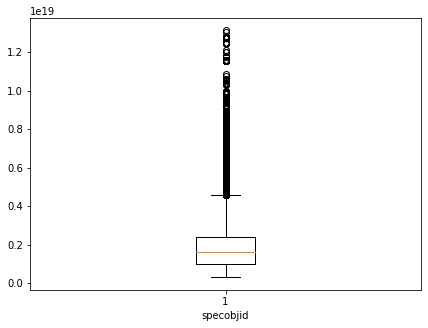

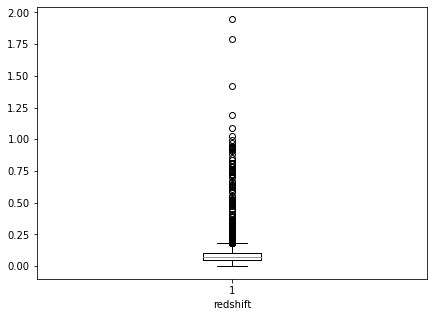

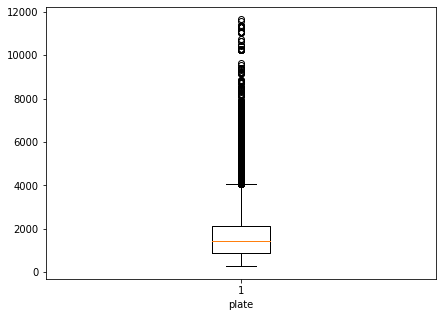

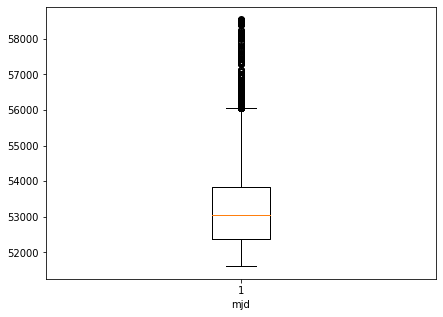

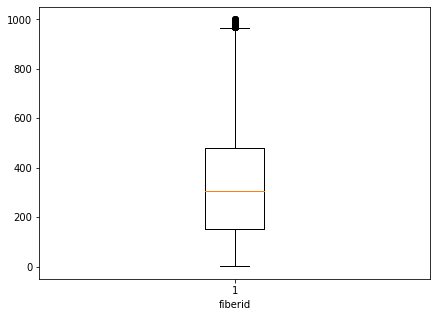

In [ ]:
for col in galaxy_sdss_df:
  plt.figure(figsize=(7,5))
  plt.boxplot(galaxy_sdss_df[col])
  plt.xlabel(col)
  plt.show()

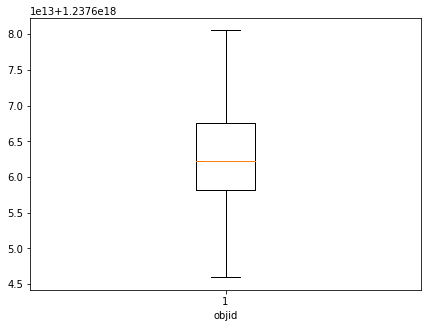

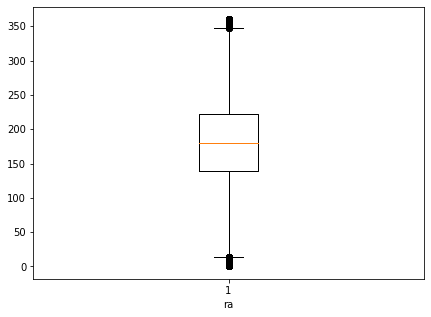

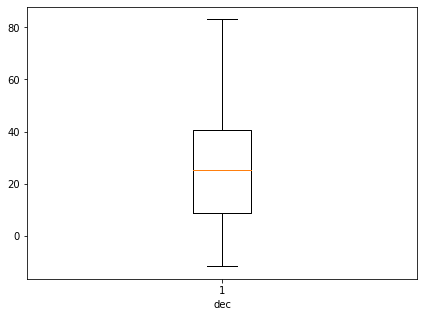

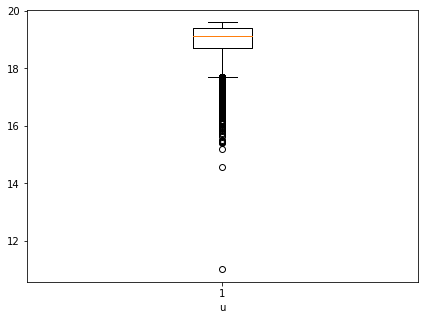

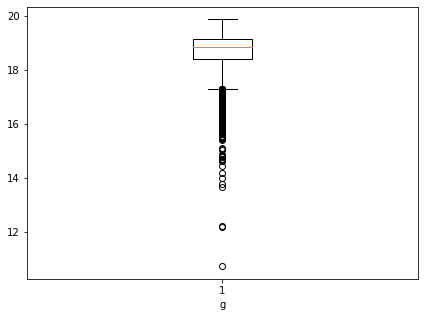

...

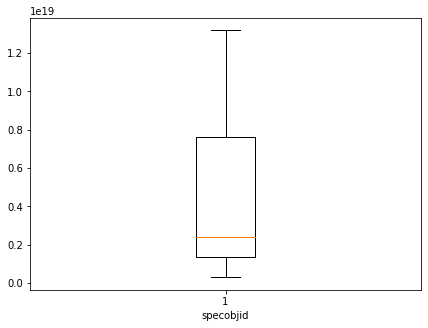

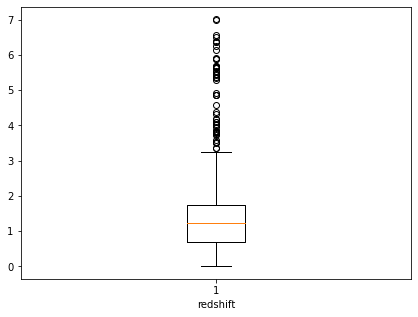

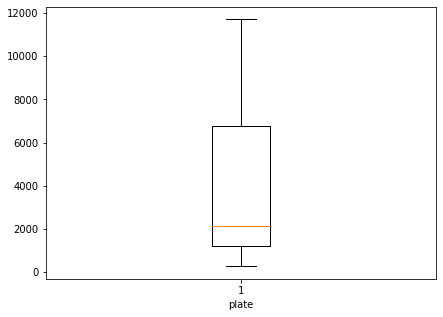

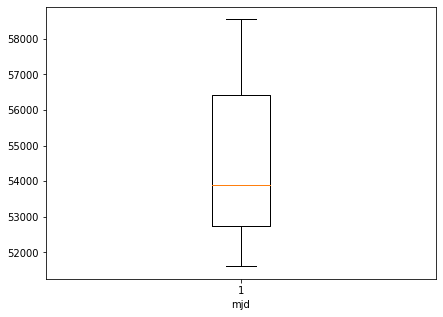

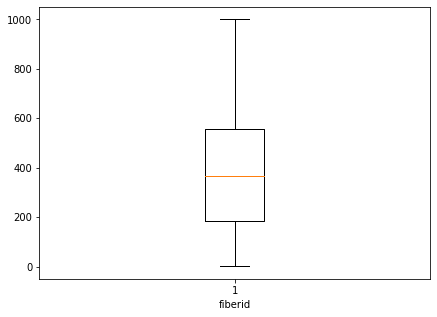

In [ ]:
for col in qso_sdss_df:
  plt.figure(figsize=(7,5))
  plt.boxplot(qso_sdss_df[col])
  plt.xlabel(col)
  plt.show()

Looking at the above boxplots, some variables will be better at identifying class objects than others.


#Dimensionality Reduction with PCA

Now that we have suffiecntly cleaned, explored, and gotten intimate with our data, we can move on to dimensionality reduction. We are going to run PCA, t-SNE,  and UMAP. After we determine the best technique, we will use it to visualize our clustering. We will start with PCA after standardizing our data. 

**NOTE**: We are going to exclude the fact that we have the ground truth data for the time being. We will run dimensionality reduction and clustering then choose the best model and compare it to our ground truths. 

In [ ]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import plotly.express as px

In [ ]:
X = sdss_df.drop(['class'], axis=1)
y = sdss_df['class']

scaler = StandardScaler()
X_std = scaler.fit_transform(X)

In [ ]:
pca = PCA(n_components=2)
components = pca.fit_transform(X_std)

fig = px.scatter(components, x=0, y=1)
fig.show()

Looking at our PCA visualization, we can see that it did not nicely cluster our classes together. we will try increasing the comppnents and see if it gets better.

In [ ]:
!pip install umap-learn
import umap

In [ ]:
umap_results = umap.UMAP(n_neighbors=3, min_dist=0.3, metric='correlation').fit_transform(X_std)

In [ ]:
fig = px.scatter(umap_results, x=0, y=1)
fig.show()

We can see that our UMAP visualization is very semetrical, but not very well segmented. We will try UMAP with a fwe different values of neighbors.

#Clustering

Now that we have used some of the dimensionality techniques, we will apply some to clustering techniques. It's appeared as though UMAP paired with the GMM clustering algorithm will work best but we will start with KMeans and move through hierarchical, DBSCAN, and finally GMM. We will evaluate the cluster based on their Adjusted Rand index score and silhouette scores.


In [ ]:
from sklearn.cluster import KMeans, MiniBatchKMeans
from sklearn import metrics

In [ ]:
pca = PCA(n_components=15)

pca.fit(X_std)

pca_EVR = pca.explained_variance_ratio_

#want majority of info to lie within first n compoennts(25% is the threshold)

In [ ]:
sum(pca_EVR[0:9])

0.96528138153752

In [ ]:
mini_cluster = MiniBatchKMeans(n_clusters=2, batch_size=1000, random_state=123)

pca_results = PCA(n_components=8).fit_transform(X_std)

mini_cluster.fit(pca_results)

y_pred1 = mini_cluster.predict(pca_results)

fig = px.scatter(pca_results, x=0, y=1, color=y_pred1)

fig.show()

In [ ]:
print('ARI score for kmeans cluster2: {}'.format(metrics.adjusted_rand_score(y, y_pred1)))
print('Silhouette score for kmeans cluster2: {}'.format(metrics.silhouette_score(X_std, y_pred1, metric='euclidean')))

ARI score for kmeans cluster2: 0.004067639103144532
Silhouette score for kmeans cluster2: 0.15045797790730334


In [ ]:
#cluster with k=3, pca ran with first 8 components, visualized using pca results

km_cluster3 = KMeans(n_clusters=3, random_state=123)

pca_results = PCA(n_components=8).fit_transform(X_std)

km_cluster2.fit(pca_results)

y_pred2 = km_cluster2.predict(pca_results)

fig = px.scatter(pca_results, x=0, y=1, color=y_pred2)
fig.show()

#scores may not improve massively when using pca_data for the clustering model

In [ ]:
print('ARI score for kmeans cluster2: {}'.format(metrics.adjusted_rand_score(y, y_pred2)))
print('Silhouette score for kmeans cluster2: {}'.format(metrics.silhouette_score(X_std, y_pred2, metric='euclidean')))

ARI score for kmeans cluster2: 0.07196521720642855
Silhouette score for kmeans cluster2: 0.1783880112105791


Looking at the ARI and SS metrics, this does not appear to have worked very well. The highest scores came from the 2 and 3 cluster models, respectively. I am fairly convinced by the visualizations that their are 2  or 3 classes. We will continue to run some DBSCAN models.

#DBSCAN Clustering

In [ ]:
from sklearn.cluster import DBSCAN

In [ ]:
dbscan_cluster = DBSCAN(eps=1, min_samples=5)

d_cluster = dbscan_cluster.fit_predict(X_std)

pca = PCA(n_components=8).fit_transform(X_std)

fig = px.scatter(pca, x=0, y=1, color=d_cluster)
fig.show()

In [ ]:
print('ARI of the Kmeans cluster: {}'.format(metrics.adjusted_rand_score(y, d_cluster)))
print('silhouette score for Kmeans cluster: {}'.format(metrics.silhouette_score(X_std, d_cluster, metric='euclidean' )))

ARI of the Kmeans cluster: 0.16242715628987214
silhouette score for Kmeans cluster: -0.436207767152321


In [ ]:
dbscan_cluster = DBSCAN(eps=1, min_samples=2)

d_cluster = dbscan_cluster.fit_predict(X_std)

pca = PCA(n_components=8).fit_transform(X_std)

fig = px.scatter(pca, x=0, y=1, color=d_cluster)
fig.show()

In [ ]:
print('ARI of the Kmeans cluster: {}'.format(metrics.adjusted_rand_score(y, d_cluster)))
print('silhouette score for Kmeans cluster: {}'.format(metrics.silhouette_score(X_std, d_cluster, metric='euclidean' )))

ARI of the Kmeans cluster: 0.14132124578869956
silhouette score for Kmeans cluster: -0.48177246819248537


#GMM Clustering

In [ ]:
from sklearn.mixture import GaussianMixture

In [ ]:
gmm_cluster = GaussianMixture(n_components=3, random_state=123,covariance_type='spherical')

g_cluster = gmm_cluster.fit_predict(X_std)

pca = PCA(n_components=8).fit_transform(X_std)

fig = px.scatter(pca, x=0, y=1, color=g_cluster)
fig.show()

In [ ]:
print('ARI of the Kmeans cluster: {}'.format(metrics.adjusted_rand_score(y, d_cluster)))
print('silhouette score for Kmeans cluster: {}'.format(metrics.silhouette_score(X_std, d_cluster, metric='euclidean' )))

ARI of the Kmeans cluster: 0.16242715628987214
silhouette score for Kmeans cluster: -0.436207767152321


In [ ]:
gmm_cluster = GaussianMixture(n_components=3, random_state=123, covariance_type='spherical')

g_cluster = gmm_cluster.fit_predict(X_std)

pca = PCA(n_components=8).fit_transform(X_std)

fig = px.scatter(pca, x=0, y=1, color=g_cluster)
fig.show()

In [ ]:
print('ARI of the Kmeans cluster: {}'.format(metrics.adjusted_rand_score(y, g_cluster)))
print('silhouette score for Kmeans cluster: {}'.format(metrics.silhouette_score(X_std, g_cluster, metric='euclidean' )))

ARI of the Kmeans cluster: 0.1513395548646116
silhouette score for Kmeans cluster: 0.1633899423849962


In [ ]:
pca = PCA(n_components=8)
components = pca.fit_transform(X_std)

fig = px.scatter(components, x=0, y=1, color=y)
fig.show()

#Why are our Scores so low?

Our best performing model was the GMM cluster and had an ARI score of .15 and SS of .16. The other models had mostly single digit ARI score and lower or negative SS.

Looking at the ARI and Silhouette Scores, one would assume they are incredibly low for these powerful models. But to get a better idea of why, we need to look at what these two metrics are actually measuring. 

According to the Scikit Learn documentation:

ARI score:

"The Rand Index computes a similarity measure between two clusterings by considering all pairs of samples and counting pairs that are assigned in the same or different clusters in the predicted and true clusterings. ...
The adjusted Rand index is thus ensured to have a value close to 0.0 for random labeling independently of the number of clusters and samples and exactly 1.0 when the clusterings are identical (up to a permutation)."

Silhouette Score:

"The best value is 1 and the worst value is -1. Values near 0 indicate overlapping clusters. Negative values generally indicate that a sample has been assigned to the wrong cluster, as a different cluster is more similar."

So having an ARI score close to zero like we do would indicate that we have nearly randomly labeled clusters. 

And having a low Silhouette Score indicates that our true groups of stars, galaxies, and pulsars could overlap. I would tend to agree looking at the above scatterplot. 

Another possible issue is the data imbalance between our ground truth observations.

Star: 38,096

Galaxy: 51,323

Quasar: 10,581

This may cause an issue when training our clustering algorithms since Galaxies make up over 50% of our data points. 



